In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from datetime import date, datetime, timedelta
import plotly.offline as py
import plotly.graph_objs as go
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from datetime import datetime
from pytz import timezone
import pytz

init_notebook_mode(connected=True)

In [3]:
turbine_readings = pd.read_csv('./data/WindData_scrubbed.csv')
print(turbine_readings.shape)

(2600, 86)


In [4]:
wu_data = pd.read_csv("hourly_weather_data.csv")

In [5]:
wu_data.head()

,blunt_phrase,class,clds,day_ind,dewPt,expire_time_gmt,feels_like,gust,heat_index,icon_extd,...,uv_index,valid_time_gmt,vis,water_temp,wc,wdir,wdir_cardinal,wspd,wx_icon,wx_phrase
0,NaN,observation,CLR,N,5.0,1451642400,20.0,NaN,28.0,3300.0,...,0,1451635200,10.0,NaN,20.0,10.0,N,8.0,33.0,Fair
1,NaN,observation,CLR,N,5.0,1451643600,21.0,NaN,28.0,3300.0,...,0,1451636400,10.0,NaN,21.0,20.0,NNE,7.0,33.0,Fair
2,NaN,observation,CLR,N,5.0,1451644800,22.0,NaN,28.0,3300.0,...,0,1451637600,10.0,NaN,22.0,20.0,NNE,6.0,33.0,Fair
3,NaN,observation,CLR,N,5.0,1451646000,30.0,NaN,30.0,3300.0,...,0,1451638800,10.0,NaN,30.0,NaN,CALM,0.0,33.0,Fair
4,NaN,observation,CLR,N,5.0,1451647200,28.0,NaN,28.0,3300.0,...,0,1451640000,10.0,NaN,28.0,NaN,CALM,0.0,33.0,Fair


In [6]:
wu_data.columns

Index(['blunt_phrase', 'class', 'clds', 'day_ind', 'dewPt', 'expire_time_gmt',
       'feels_like', 'gust', 'heat_index', 'icon_extd', 'key', 'max_temp',
       'min_temp', 'obs_id', 'obs_name', 'precip_hrly', 'precip_total',
       'pressure', 'pressure_desc', 'pressure_tend', 'primary_swell_direction',
       'primary_swell_height', 'primary_swell_period', 'primary_wave_height',
       'primary_wave_period', 'qualifier', 'qualifier_svrty', 'rh',
       'secondary_swell_direction', 'secondary_swell_height',
       'secondary_swell_period', 'snow_hrly', 'temp', 'terse_phrase',
       'uv_desc', 'uv_index', 'valid_time_gmt', 'vis', 'water_temp', 'wc',
       'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase'],
      dtype='object')

In [7]:
wu_data[['expire_time_gmt',
       'feels_like', 'obs_id', 
       'pressure',   'rh',
        'temp', 'valid_time_gmt', 'vis', 'wc',
       'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase']].head()

,expire_time_gmt,feels_like,obs_id,pressure,rh,temp,valid_time_gmt,vis,wc,wdir,wdir_cardinal,wspd,wx_icon,wx_phrase
0,1451642400,20.0,KMHV,27.26,37.0,28.0,1451635200,10.0,20.0,10.0,N,8.0,33.0,Fair
1,1451643600,21.0,KMHV,27.25,37.0,28.0,1451636400,10.0,21.0,20.0,NNE,7.0,33.0,Fair
2,1451644800,22.0,KMHV,27.25,37.0,28.0,1451637600,10.0,22.0,20.0,NNE,6.0,33.0,Fair
3,1451646000,30.0,KMHV,27.25,34.0,30.0,1451638800,10.0,30.0,NaN,CALM,0.0,33.0,Fair
4,1451647200,28.0,KMHV,27.25,37.0,28.0,1451640000,10.0,28.0,NaN,CALM,0.0,33.0,Fair


In [8]:
# Converting Unix valid time values to readable utc time stamps

def unix_to_pst(unix_ts):
    fmt = "%Y-%m-%d %H:%M:%S"
    datw = datetime.fromtimestamp(unix_ts)
    datw = datw.astimezone(timezone('US/Pacific'))
    
    return datw.strftime(fmt)

wu_data['timestamp'] = wu_data['valid_time_gmt'].apply(lambda x: unix_to_pst(x))

In [9]:
wu_data[[
       'feels_like', 'obs_id', 
       'pressure',   'rh',
        'temp',  'vis', 'wc',
       'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase', 'timestamp']].head()

,feels_like,obs_id,pressure,rh,temp,vis,wc,wdir,wdir_cardinal,wspd,wx_icon,wx_phrase,timestamp
0,20.0,KMHV,27.26,37.0,28.0,10.0,20.0,10.0,N,8.0,33.0,Fair,2016-01-01 00:00:00
1,21.0,KMHV,27.25,37.0,28.0,10.0,21.0,20.0,NNE,7.0,33.0,Fair,2016-01-01 00:20:00
2,22.0,KMHV,27.25,37.0,28.0,10.0,22.0,20.0,NNE,6.0,33.0,Fair,2016-01-01 00:40:00
3,30.0,KMHV,27.25,34.0,30.0,10.0,30.0,NaN,CALM,0.0,33.0,Fair,2016-01-01 01:00:00
4,28.0,KMHV,27.25,37.0,28.0,10.0,28.0,NaN,CALM,0.0,33.0,Fair,2016-01-01 01:20:00


In [10]:
wu_data_filt = wu_data[[
       'feels_like', 'obs_id', 
       'pressure',   'rh',
        'temp',  'vis', 'wc',
       'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase', 'timestamp']]

### We care about 'pressure',  'wdir', 'wdir_cardinal', 'wspd' for our analysis

In [11]:
start_datetime = datetime(2016, 1, 1, 0, 0, 0)
print(start_datetime)
datetime_list = []
for i in range(turbine_readings.shape[0]):
    datetime_list.append(start_datetime)
    start_datetime += timedelta(hours=1.68)

print(len(datetime_list))
turbine_readings["timestamp"] = datetime_list

2016-01-01 00:00:00
2600


In [12]:
turbine_readings.head()

,kW_Turbine1,kW_Turbine2,kW_Turbine3,kW_Turbine4,kW_Turbine5,kW_Turbine6,kW_Turbine7,kW_Turbine8,kW_Turbine9,kW_Turbine10,...,kW_Turbine78,kW_Turbine79,kW_Turbine80,kW_Turbine81,kW_Turbine82,kW_Turbine83,kW_Turbine84,kW_Turbine85,kW_Turbine86,timestamp
0,316.71,372.81,437.38,254.07,406.53,353.69,352.14,603.43,293.47,285.37,...,382.09,587.64,536.84,554.55,769.70,659.67,647.13,744.58,0.0,2016-01-01 00:00:00
1,282.87,306.45,440.01,264.08,344.24,346.44,366.67,476.47,456.23,252.07,...,429.62,372.01,373.98,351.09,399.73,385.87,385.62,461.32,0.0,2016-01-01 01:40:48
2,275.02,305.94,353.28,295.04,419.65,309.61,274.60,349.51,324.56,239.22,...,467.02,414.80,452.64,362.40,340.92,404.82,371.56,464.36,0.0,2016-01-01 03:21:36
3,360.92,363.80,322.83,300.20,305.57,297.13,344.75,301.70,297.07,290.15,...,300.92,331.75,343.06,336.79,402.32,376.38,339.41,374.92,0.0,2016-01-01 05:02:24
4,386.46,374.62,368.97,354.57,342.71,376.19,350.91,299.64,292.27,284.82,...,386.42,404.23,386.39,380.40,365.57,437.38,490.44,402.54,0.0,2016-01-01 06:43:12


In [13]:
turbine_readings.columns

Index(['kW_Turbine1', 'kW_Turbine2', 'kW_Turbine3', 'kW_Turbine4',
       'kW_Turbine5', 'kW_Turbine6', 'kW_Turbine7', 'kW_Turbine8',
       'kW_Turbine9', 'kW_Turbine10', 'kW_Turbine11', 'kW_Turbine12',
       'kW_Turbine13', 'kW_Turbine14', 'kW_Turbine15', 'kW_Turbine16',
       'kW_Turbine17', 'kW_Turbine18', 'kW_Turbine19', 'kW_Turbine20',
       'kW_Turbine21', 'kW_Turbine22', 'kW_Turbine23', 'kW_Turbine24',
       'kW_Turbine25', 'kW_Turbine26', 'kW_Turbine27', 'kW_Turbine28',
       'kW_Turbine29', 'kW_Turbine30', 'kW_Turbine31', 'kW_Turbine32',
       'kW_Turbine33', 'kW_Turbine34', 'kW_Turbine35', 'kW_Turbine36',
       'kW_Turbine37', 'kW_Turbine38', 'kW_Turbine39', 'kW_Turbine40',
       'kW_Turbine41', 'kW_Turbine42', 'kW_Turbine43', 'kW_Turbine44',
       'kW_Turbine45', 'kW_Turbine46', 'kW_Turbine47', 'kW_Turbine48',
       'kW_Turbine49', 'kW_Turbine50', 'kW_Turbine51', 'kW_Turbine52',
       'kW_Turbine53', 'kW_Turbine54', 'kW_Turbine55', 'kW_Turbine56',
       'kW_Turb

In [14]:
wu_data_filt.timestamp = pd.to_datetime(wu_data_filt.timestamp)

/Users/adi/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:4401: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [15]:
turbine_readings.timestamp = pd.to_datetime(turbine_readings.timestamp)

In [16]:
turbine_readings.timestamp.dtype

dtype('<M8[ns]')

In [17]:
wu_data_filt.timestamp.dtype

dtype('<M8[ns]')

In [18]:
temp3 = pd.merge_asof(left = turbine_readings, right = wu_data_filt, on = 'timestamp')

In [19]:
temp3 = temp3.sort_values(by=['timestamp'])

In [20]:
temp3.head()

,kW_Turbine1,kW_Turbine2,kW_Turbine3,kW_Turbine4,kW_Turbine5,kW_Turbine6,kW_Turbine7,kW_Turbine8,kW_Turbine9,kW_Turbine10,...,pressure,rh,temp,vis,wc,wdir,wdir_cardinal,wspd,wx_icon,wx_phrase
0,316.71,372.81,437.38,254.07,406.53,353.69,352.14,603.43,293.47,285.37,...,27.26,37.0,28.0,10.0,20.0,10.0,N,8.0,33.0,Fair
1,282.87,306.45,440.01,264.08,344.24,346.44,366.67,476.47,456.23,252.07,...,27.25,40.0,27.0,10.0,27.0,NaN,CALM,0.0,33.0,Fair
2,275.02,305.94,353.28,295.04,419.65,309.61,274.60,349.51,324.56,239.22,...,27.24,46.0,23.0,10.0,23.0,NaN,CALM,0.0,33.0,Fair
3,360.92,363.80,322.83,300.20,305.57,297.13,344.75,301.70,297.07,290.15,...,27.24,37.0,28.0,10.0,28.0,NaN,CALM,0.0,33.0,Fair
4,386.46,374.62,368.97,354.57,342.71,376.19,350.91,299.64,292.27,284.82,...,27.27,54.0,19.0,10.0,19.0,NaN,CALM,0.0,34.0,Fair


In [21]:
turbine_names = list(turbine_readings.columns.values)
turbine_names.remove("timestamp")
random_turbines = np.random.choice(turbine_names, size=10, replace=False)
print(random_turbines)
traces = []

for turbine in random_turbines:
    trace = go.Scatter(x = turbine_readings["timestamp"],
                       y = turbine_readings[turbine],
                       mode = 'lines',
                       name = turbine)
    traces.append(trace)

py.iplot(traces, filename='line-mode')

['kW_Turbine19' 'kW_Turbine31' 'kW_Turbine69' 'kW_Turbine37'
 'kW_Turbine46' 'kW_Turbine82' 'kW_Turbine34' 'kW_Turbine53' 'kW_Turbine2'
 'kW_Turbine50']


In [22]:
temp = list(turbine_readings.columns.values)
temp.remove("timestamp")
random_turbines = np.random.choice(temp, size=10, replace=False)
print(random_turbines)
traces = []

for turbine in random_turbines:
    trace = go.Scatter(x = turbine_readings["timestamp"],
                       y = turbine_readings[turbine],
                       mode = 'lines',
                       name = turbine)
    traces.append(trace)

py.iplot(traces, filename='line-mode')

['kW_Turbine83' 'kW_Turbine21' 'kW_Turbine61' 'kW_Turbine33'
 'kW_Turbine66' 'kW_Turbine45' 'kW_Turbine78' 'kW_Turbine55'
 'kW_Turbine58' 'kW_Turbine20']


In [23]:
turbine_readings = turbine_readings.melt(id_vars="timestamp", var_name="turbine_num", value_name="reading")

In [24]:
temp3.columns

Index(['kW_Turbine1', 'kW_Turbine2', 'kW_Turbine3', 'kW_Turbine4',
       'kW_Turbine5', 'kW_Turbine6', 'kW_Turbine7', 'kW_Turbine8',
       'kW_Turbine9', 'kW_Turbine10', 'kW_Turbine11', 'kW_Turbine12',
       'kW_Turbine13', 'kW_Turbine14', 'kW_Turbine15', 'kW_Turbine16',
       'kW_Turbine17', 'kW_Turbine18', 'kW_Turbine19', 'kW_Turbine20',
       'kW_Turbine21', 'kW_Turbine22', 'kW_Turbine23', 'kW_Turbine24',
       'kW_Turbine25', 'kW_Turbine26', 'kW_Turbine27', 'kW_Turbine28',
       'kW_Turbine29', 'kW_Turbine30', 'kW_Turbine31', 'kW_Turbine32',
       'kW_Turbine33', 'kW_Turbine34', 'kW_Turbine35', 'kW_Turbine36',
       'kW_Turbine37', 'kW_Turbine38', 'kW_Turbine39', 'kW_Turbine40',
       'kW_Turbine41', 'kW_Turbine42', 'kW_Turbine43', 'kW_Turbine44',
       'kW_Turbine45', 'kW_Turbine46', 'kW_Turbine47', 'kW_Turbine48',
       'kW_Turbine49', 'kW_Turbine50', 'kW_Turbine51', 'kW_Turbine52',
       'kW_Turbine53', 'kW_Turbine54', 'kW_Turbine55', 'kW_Turbine56',
       'kW_Turb

In [25]:
temp4 = temp3.melt(id_vars=['timestamp', 'feels_like', 'obs_id',
       'pressure', 'rh', 'temp', 'vis', 'wc', 'wdir', 'wdir_cardinal', 'wspd',
       'wx_icon', 'wx_phrase'] , var_name="turbine_num", value_name="reading")

In [26]:
temp4.columns

Index(['timestamp', 'feels_like', 'obs_id', 'pressure', 'rh', 'temp', 'vis',
       'wc', 'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase',
       'turbine_num', 'reading'],
      dtype='object')

In [27]:
max(temp4.reading)

1705.8

In [28]:
min(temp4.reading)

0.0

In [29]:
temp4.turbine_num.unique()

array(['kW_Turbine1', 'kW_Turbine2', 'kW_Turbine3', 'kW_Turbine4',
       'kW_Turbine5', 'kW_Turbine6', 'kW_Turbine7', 'kW_Turbine8',
       'kW_Turbine9', 'kW_Turbine10', 'kW_Turbine11', 'kW_Turbine12',
       'kW_Turbine13', 'kW_Turbine14', 'kW_Turbine15', 'kW_Turbine16',
       'kW_Turbine17', 'kW_Turbine18', 'kW_Turbine19', 'kW_Turbine20',
       'kW_Turbine21', 'kW_Turbine22', 'kW_Turbine23', 'kW_Turbine24',
       'kW_Turbine25', 'kW_Turbine26', 'kW_Turbine27', 'kW_Turbine28',
       'kW_Turbine29', 'kW_Turbine30', 'kW_Turbine31', 'kW_Turbine32',
       'kW_Turbine33', 'kW_Turbine34', 'kW_Turbine35', 'kW_Turbine36',
       'kW_Turbine37', 'kW_Turbine38', 'kW_Turbine39', 'kW_Turbine40',
       'kW_Turbine41', 'kW_Turbine42', 'kW_Turbine43', 'kW_Turbine44',
       'kW_Turbine45', 'kW_Turbine46', 'kW_Turbine47', 'kW_Turbine48',
       'kW_Turbine49', 'kW_Turbine50', 'kW_Turbine51', 'kW_Turbine52',
       'kW_Turbine53', 'kW_Turbine54', 'kW_Turbine55', 'kW_Turbine56',
       'kW_Turb

In [30]:
turbine_readings["date"] = turbine_readings["timestamp"].dt.date
print(turbine_readings.head())

            timestamp  turbine_num  reading        date
0 2016-01-01 00:00:00  kW_Turbine1   316.71  2016-01-01
1 2016-01-01 01:40:48  kW_Turbine1   282.87  2016-01-01
2 2016-01-01 03:21:36  kW_Turbine1   275.02  2016-01-01
3 2016-01-01 05:02:24  kW_Turbine1   360.92  2016-01-01
4 2016-01-01 06:43:12  kW_Turbine1   386.46  2016-01-01


In [31]:
temp4["date"] = temp4["timestamp"].dt.date
print(temp4.head())

            timestamp  feels_like obs_id  pressure    rh  temp   vis    wc  \
0 2016-01-01 00:00:00        20.0   KMHV     27.26  37.0  28.0  10.0  20.0   
1 2016-01-01 01:40:48        27.0   KMHV     27.25  40.0  27.0  10.0  27.0   
2 2016-01-01 03:21:36        23.0   KMHV     27.24  46.0  23.0  10.0  23.0   
3 2016-01-01 05:02:24        28.0   KMHV     27.24  37.0  28.0  10.0  28.0   
4 2016-01-01 06:43:12        19.0   KMHV     27.27  54.0  19.0  10.0  19.0   

   wdir wdir_cardinal  wspd  wx_icon wx_phrase  turbine_num  reading  \
0  10.0             N   8.0     33.0      Fair  kW_Turbine1   316.71   
1   NaN          CALM   0.0     33.0      Fair  kW_Turbine1   282.87   
2   NaN          CALM   0.0     33.0      Fair  kW_Turbine1   275.02   
3   NaN          CALM   0.0     33.0      Fair  kW_Turbine1   360.92   
4   NaN          CALM   0.0     34.0      Fair  kW_Turbine1   386.46   

         date  
0  2016-01-01  
1  2016-01-01  
2  2016-01-01  
3  2016-01-01  
4  2016-01-01  


In [32]:
daily_mean_turbine_reading = turbine_readings.groupby(["date", "turbine_num"], as_index=False)["reading"].mean()
daily_mean_turbine_reading.head()

station_files = ["./data_2016/weather_2016/projects/Alta X/GHCND_USW00003159/",
                 "./data_2016/weather_2016/projects/Alta X/GHCND_USW00053144/",
                 "./data_2016/weather_2016/projects/Alta XI/GHCND_USW00023187/"]

feature_files = []

for station in station_files:
    for filename in os.listdir(station):
        if filename.endswith(".csv"):
            feature_files.append(station+filename)

for feature_file in feature_files:
    df = pd.read_csv(feature_file)
    df["date"] = df["date"].str.split("T", expand=True)[0]
    df["date"] = pd.to_datetime(df["date"]).dt.date
    df.rename(columns={"value": (df["station"][0] + "|" + df["datatype"][0])}, inplace=True)
    df = df[["date", (df["station"][0] + "|" + df["datatype"][0])]]
    #print(df.info(), daily_mean_turbine_reading.info())
    #print(type(df["date"]), type(daily_mean_turbine_reading["date"]))
    #print(df["date"][0], daily_mean_turbine_reading["date"][0])
    #print(df["date"][0] == daily_mean_turbine_reading["date"][0])
    daily_mean_turbine_reading = pd.merge(daily_mean_turbine_reading, df, on="date", how="left")

print(daily_mean_turbine_reading.head())

         date   turbine_num     reading  GHCND:USW00003159|WSF2  \
0  2016-01-01   kW_Turbine1  837.602667                    10.1   
1  2016-01-01  kW_Turbine10  759.655333                    10.1   
2  2016-01-01  kW_Turbine11  544.115333                    10.1   
3  2016-01-01  kW_Turbine12  823.235333                    10.1   
4  2016-01-01  kW_Turbine13  789.448667                    10.1   

   GHCND:USW00003159|WDF2  GHCND:USW00003159|WDF5  GHCND:USW00003159|AWND  \
0                      50                    70.0                     4.9   
1                      50                    70.0                     4.9   
2                      50                    70.0                     4.9   
3                      50                    70.0                     4.9   
4                      50                    70.0                     4.9   

   GHCND:USW00003159|WSF5  GHCND:USW00003159|TMIN  GHCND:USW00003159|TMAX  \
0                    15.0                    14.0        

In [33]:
daily_mean_turbine_reading.columns

Index(['date', 'turbine_num', 'reading', 'GHCND:USW00003159|WSF2',
       'GHCND:USW00003159|WDF2', 'GHCND:USW00003159|WDF5',
       'GHCND:USW00003159|AWND', 'GHCND:USW00003159|WSF5',
       'GHCND:USW00003159|TMIN', 'GHCND:USW00003159|TMAX',
       'GHCND:USW00053144|WSF2', 'GHCND:USW00053144|WDF2',
       'GHCND:USW00053144|WDF5', 'GHCND:USW00053144|AWND',
       'GHCND:USW00053144|PGTM', 'GHCND:USW00053144|WSF5',
       'GHCND:USW00053144|TMIN', 'GHCND:USW00053144|TMAX',
       'GHCND:USW00023187|WSF2', 'GHCND:USW00023187|WDF2',
       'GHCND:USW00023187|WDF5', 'GHCND:USW00023187|AWND',
       'GHCND:USW00023187|PGTM', 'GHCND:USW00023187|WSF5',
       'GHCND:USW00023187|TMIN', 'GHCND:USW00023187|TMAX'],
      dtype='object')

In [165]:
traces = []
random_turbines = np.random.choice(turbine_names, size=3, replace=False)


for turbine in random_turbines:
    filtered_turbine = daily_mean_turbine_reading.loc[daily_mean_turbine_reading["turbine_num"] == turbine]
    trace = go.Scatter(x = filtered_turbine["date"],
                       y = filtered_turbine["reading"],
                       mode = 'lines',
                       name = turbine)
    
traces.append(trace)


topher = go.Scatter(x = filtered_turbine["date"],
                       y = filtered_turbine["GHCND:USW00003159|AWND"],
                       mode = 'lines',
                       name = 'AWND-3159',
                    yaxis = 'y2'
                   )
                        

topher2 = go.Scatter(x = filtered_turbine["date"],
                       y = filtered_turbine["GHCND:USW00023187|AWND"],
                       mode = 'lines',
                       name = 'AWND-23187'                    )



traces.append(topher)

traces.append(topher2)

layout = go.Layout(
    title='Time Series - Wind Speed (NOAA data), Turbine Output',
    yaxis=dict(
        title='Turbine Output (kWh)',
        #title='Wind Speed (mph)',
        titlefont=dict(
            color='blue'
        ),
        tickfont=dict(
            color='blue'
        ),
    ),
    yaxis2=dict(
        title='Wind Speed (mph)',
        titlefont=dict(
            color='orange'
        ),
        tickfont=dict(
            color='orange'
        ),
        overlaying='y',
        side='right'
    )
)
fig = go.Figure(data=traces, layout=layout)
#plot_url = py.plot(fig, filename='multiple-axes-double')

py.iplot(fig, filename='line-mode')

In [128]:
traces = []
random_turbines = np.random.choice(turbine_names, size=3, replace=False)


for turbine in random_turbines:
    filtered_turbine = temp4.loc[temp4["turbine_num"] == turbine]
    trace = go.Scatter(x = filtered_turbine["timestamp"],
                       y = filtered_turbine["reading"],
                       mode = 'lines',
                       name = turbine)
    traces.append(trace)


topher = go.Scatter(x = filtered_turbine["timestamp"],
                       y = filtered_turbine["wspd"],
                       mode = 'lines',
                       name = 'wind speed',
                    yaxis='y2'
                   )

topher2 = go.Scatter(x = filtered_turbine["timestamp"],
                       y = filtered_turbine["temp"],
                       mode = 'lines',
                       name = 'Temperature')

topher3 = go.Scatter(x = filtered_turbine["timestamp"],
                       y = filtered_turbine["pressure"],
                       mode = 'lines',
                       name = 'Pressure')




traces.append(topher)

traces.append(topher2)

traces.append(topher3)


layout = go.Layout(
    title='Time Series - Wind Speed (WU data), Turbine Output',
    yaxis=dict(
        title='Turbine Output (kWh)',
        #title='Wind Speed (mph)',
        titlefont=dict(
            color='green'
        ),
        tickfont=dict(
            color='green'
        ),
    ),
    yaxis2=dict(
        title='Wind Speed (mph)',
        titlefont=dict(
            color='red'
        ),
        tickfont=dict(
            color='red'
        ),
        overlaying='y',
        side='right'
    )
)
fig = go.Figure(data=traces, layout=layout)
#plot_url = py.plot(fig, filename='multiple-axes-double')

py.iplot(fig, filename='line-mode')

In [129]:
traces = []
random_turbines = np.random.choice(turbine_names, size=3, replace=False)


for turbine in random_turbines:
    filtered_turbine = temp4.loc[temp4["turbine_num"] == turbine]
    trace = go.Scatter(x = filtered_turbine["timestamp"],
                       y = filtered_turbine["reading"],
                       mode = 'lines',
                       name = turbine)
    traces.append(trace)


topher = go.Scatter(x = filtered_turbine["timestamp"],
                       y = filtered_turbine["wspd"],
                       mode = 'lines',
                       name = 'wind speed',
                    yaxis='y2'
                   )





traces.append(topher)



layout = go.Layout(
    title='Time Series - Wind Speed, Turbine Output',
    yaxis=dict(
        title='Turbine Output (kWh)',
        #title='Wind Speed (mph)',
        titlefont=dict(
            color='green'
        ),
        tickfont=dict(
            color='green'
        ),
    ),
    yaxis2=dict(
        title='Wind Speed (mph)',
        titlefont=dict(
            color='red'
        ),
        tickfont=dict(
            color='red'
        ),
        overlaying='y',
        side='right'
    )
)
fig = go.Figure(data=traces, layout=layout)
#plot_url = py.plot(fig, filename='multiple-axes-double')

py.iplot(fig, filename='line-mode')

In [36]:
temp4.head()

,timestamp,feels_like,obs_id,pressure,rh,temp,vis,wc,wdir,wdir_cardinal,wspd,wx_icon,wx_phrase,turbine_num,reading,date
0,2016-01-01 00:00:00,20.0,KMHV,27.26,37.0,28.0,10.0,20.0,10.0,N,8.0,33.0,Fair,kW_Turbine1,316.71,2016-01-01
1,2016-01-01 01:40:48,27.0,KMHV,27.25,40.0,27.0,10.0,27.0,NaN,CALM,0.0,33.0,Fair,kW_Turbine1,282.87,2016-01-01
2,2016-01-01 03:21:36,23.0,KMHV,27.24,46.0,23.0,10.0,23.0,NaN,CALM,0.0,33.0,Fair,kW_Turbine1,275.02,2016-01-01
3,2016-01-01 05:02:24,28.0,KMHV,27.24,37.0,28.0,10.0,28.0,NaN,CALM,0.0,33.0,Fair,kW_Turbine1,360.92,2016-01-01
4,2016-01-01 06:43:12,19.0,KMHV,27.27,54.0,19.0,10.0,19.0,NaN,CALM,0.0,34.0,Fair,kW_Turbine1,386.46,2016-01-01


In [37]:
random_turbines

array(['kW_Turbine26', 'kW_Turbine24', 'kW_Turbine70'], dtype='<U12')

In [172]:
random_turbines = np.random.choice(turbine_names, size=1, replace=False)
print(random_turbines)
filtered_turbine = daily_mean_turbine_reading.loc[daily_mean_turbine_reading["turbine_num"] == turbine]

features_list = ["AWND", "WSF5", "WSF2", "WDF5", "WDF2", "PGTM"]

for feature in features_list:
    traces = []
    for turbine in random_turbines:
        for column in filtered_turbine:
            if column.endswith(feature):
                trace = go.Scatter(x=filtered_turbine[column],
                                   y=filtered_turbine["reading"],
                                   name=column,
                                   mode='markers')
                traces.append(trace)
                
    layout = go.Layout(
        title='Turbine Output v ' + feature,
        yaxis=dict(
            title='Turbine Output (kWh)'
            #title='Wind Speed (mph)',
            
        ),
        xaxis = dict(
            title = 'Average Wind Speed - NOAA (mph)'
        )
    )
    fig = go.Figure(data=traces, layout=layout)
    #plot_url = py.plot(fig, filename='multiple-axes-double')

    py.iplot(fig, filename='scatter-mode')
    #layout = 
    #py.iplot(traces, filename='basic-scatter')

['kW_Turbine29']


In [39]:
temp4.columns

Index(['timestamp', 'feels_like', 'obs_id', 'pressure', 'rh', 'temp', 'vis',
       'wc', 'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase',
       'turbine_num', 'reading', 'date'],
      dtype='object')

In [40]:
min(temp4.pressure)

26.61

In [41]:
max(temp4.pressure)

27.54

In [42]:
stations = ["GHCND:USW00003159|", "GHCND:USW00053144|", "GHCND:USW00023187|"]
filtered_turbine = daily_mean_turbine_reading.loc[daily_mean_turbine_reading["turbine_num"] == random_turbines[0]]

for feature in features_list:
    traces = []
    for station in stations:
        try:
            trace = go.Scatter(x = filtered_turbine["date"],
                               y = filtered_turbine[station+feature],
                               mode = 'lines',
                               name = station+feature)
            traces.append(trace)
        except:
            print("Feature not available.")
    py.iplot(traces, filename='line-mode')

Feature not available.


In [43]:
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
import plotly.offline as py
import plotly.graph_objs as go
from scipy import stats
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
%matplotlib inline


def plot_hist(x, x_label, y_label, title, start = None, end = None, size = None, hist_norm = None, color = None, opacity = 0.5):
    #x = np.random.randn(500)
    x0 = x
    
    trace1 = go.Histogram(
        x=x0,
        histnorm = hist_norm,
        name='control',
        xbins=dict(
            start=start,
            end=end,
            size=size
        ),
        marker=dict(
            color=color,
        ),
        opacity=opacity
    )
    
    
    
    
    data = [trace1]
    
    layout = go.Layout(
        title=title,
        xaxis=dict(
            title=x_label,
            titlefont=dict(
                family='Courier New, monospace',
                size=18,
                color='#7f7f7f'
            )
        ),
        yaxis=dict(
            title=y_label,
            titlefont=dict(
                family='Courier New, monospace',
                size=18,
                color='#7f7f7f'
            )
        )
    )
    
    

    #data = [trace]
    fig = go.Figure(data=data, layout=layout)

    # Plot and embed in ipython notebook!
    py.iplot(fig, filename='basic-hist')



    #py.iplot(data, filename='basic histogram')

In [44]:
def overlaid_hist(x1, x2, x3, opacity = 0.5):
    
    trace1 = go.Histogram(
        x=x1,
        
        
        opacity=opacity
    )
    trace2 = go.Histogram(
        x=x2,
        opacity=opacity
    )
    
    trace3 = go.Histogram(
        x=x3,
        opacity=opacity
    )

    data = [trace1, trace2, trace3]
    layout = go.Layout(barmode='overlay')
    fig = go.Figure(data=data, layout=layout)

    py.iplot(fig, filename='overlaid histogram')

In [45]:
def scatter_plot(x, y, text= None, x_label = '', y_label= '', title='', color = 'green', opacity = 0.5):
    # Create random data with numpy
    #import numpy as np

    #N = 1000
    random_x = x
    random_y = y
    text = text

    
    #random_x = consolidated.value
    #random_y = np.log(consolidated.t_cap)

    # Create a trace
    trace = go.Scatter(
        x = random_x,
        y = random_y,
        mode = 'markers',
        text = text,
        marker=dict(
            #size=16,
            opacity = opacity,
            color = color, #set color equal to a variable
            colorscale='Viridis',
            showscale=True
        )
    )
    
    layout = go.Layout(
        title=title,
        xaxis=dict(
            title=x_label,
            titlefont=dict(
                family='Courier New, monospace',
                size=18,
                color='#7f7f7f'
            )
        ),
        yaxis=dict(
            title=y_label,
            titlefont=dict(
                family='Courier New, monospace',
                size=18,
                color='#7f7f7f'
            )
        )
    )
    
    

    data = [trace]
    fig = go.Figure(data=data, layout=layout)

    # Plot and embed in ipython notebook!
    py.iplot(fig, filename='basic-scatter')




In [134]:
def box_plot(data, categories = "", numeric = '', title = '', x_label = '', y_label = ''):
    y0 = np.random.randn(50)
    y1 = np.random.randn(50)+1
    
    traces = []
    
    rang = []
    
    length = len(data[categories].unique())
    array = list(data[categories].unique())
    array = [str(aplet) for aplet in array]
    array = sorted(array)
    
    
    for unit in array:
        #unit = str(unit)
        traces.append(
            go.Box(
            y=data[numeric][data[categories] == unit],
            name = unit,
            #boxpoints='all',
            #jitter=0.3,
            #pointpos=-1.5,
            #marker = dict(
                #colorscale = 'Viridis',
                #color = 0.5,
                #)
            )
        

    
        )
        
        
        
    layout = go.Layout(
        title=title,
        xaxis=dict(
            title=x_label,
            titlefont=dict(
                family='Courier New, monospace',
                size=18,
                color='#7f7f7f'
            )
        ),
        yaxis=dict(
            title=y_label,
            titlefont=dict(
                family='Courier New, monospace',
                size=18,
                color='#7f7f7f'
            )
        )
    )    
    data = traces
    
    fig = go.Figure(data=data, layout=layout)

    # Plot and embed in ipython notebook!
    py.iplot(fig, filename='categorical-boxplot')
    #py.iplot(data)

In [47]:
temp4.columns

Index(['timestamp', 'feels_like', 'obs_id', 'pressure', 'rh', 'temp', 'vis',
       'wc', 'wdir', 'wdir_cardinal', 'wspd', 'wx_icon', 'wx_phrase',
       'turbine_num', 'reading', 'date'],
      dtype='object')

In [149]:
box_plot(temp4, 
         categories='wdir_cardinal', 
         numeric='reading', 
         title='Distribution of wind output by wind direction', 
         x_label='Wind Direction', 
         y_label='Output')

In [49]:
box_plot(temp4, categories='wdir_cardinal', numeric='reading', title='Distribution of wind output by wind direction', x_label='Wind Direction', y_label='Output')

In [130]:
scatter_plot(x = temp4[temp4.turbine_num == 'kW_Turbine84'].wspd , 
             y = temp4[temp4.turbine_num == 'kW_Turbine84']["reading"] , 
             title = 'Wind Speed Vs Output for kw_Turbine84', 
             x_label="Wind Speed", 
             y_label = 'Output',
             opacity = 0.3)

In [135]:
box_plot(temp4[temp4.turbine_num == 'kW_Turbine84'], 
         categories='wdir_cardinal', 
         numeric='reading', 
         title='Distribution of wind output by wind direction for kW_Turbine84', 
         x_label='Wind Direction', 
         y_label='Output')

In [66]:
temp5 = temp4[['reading','timestamp']][temp4.turbine_num == 'kW_Turbine12']

In [68]:
temp5 = temp5.set_index('timestamp')

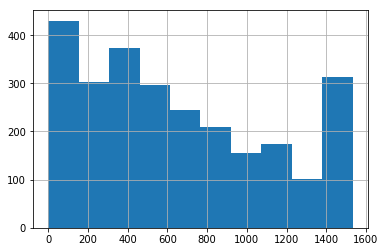

In [86]:
temp5.reading

In [88]:
ranga = pd.date_range(start= '1/1/2016', periods = 2600, freq='5T')
temp6 = pd.Series( list(temp5.reading), index= ranga)

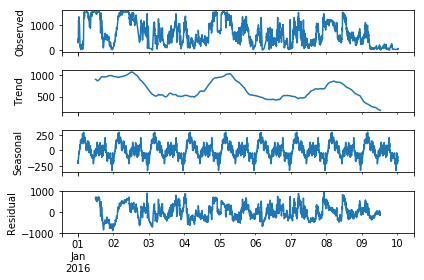

In [148]:
frew = (24*60)//5
#frew = 6*12
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(temp6, model='additive', freq= frew)
fig = decomposition.plot()

In [102]:
temp4[['timestamp','temp']]


,timestamp,temp
0,2016-01-01 00:00:00,28.0
1,2016-01-01 01:40:48,27.0
2,2016-01-01 03:21:36,23.0
3,2016-01-01 05:02:24,28.0
4,2016-01-01 06:43:12,19.0
5,2016-01-01 08:24:00,32.0
6,2016-01-01 10:04:48,37.0
7,2016-01-01 11:45:36,41.0
8,2016-01-01 13:26:24,43.0
9,2016-01-01 15:07:12,43.0


In [112]:
k = pd.Series(list(temp4.temp), index=temp4.timestamp)
k = k.dropna()

In [117]:
k.head()

timestamp
2016-01-01 00:00:00    28.0
2016-01-01 01:40:48    27.0
2016-01-01 03:21:36    23.0
2016-01-01 05:02:24    28.0
2016-01-01 06:43:12    19.0
dtype: float64

In [119]:
frew = (24*60)//5
frew = 6*12
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(k, model='additive', freq='1H40min48sec')
fig = decomposition.plot()

TypeError: not all arguments converted during string formatting

In [150]:
temp6

2016-01-01 00:00:00     335.890
2016-01-01 00:05:00     439.490
2016-01-01 00:10:00     352.320
2016-01-01 00:15:00     286.940
2016-01-01 00:20:00     318.770
2016-01-01 00:25:00     433.650
2016-01-01 00:30:00     888.570
2016-01-01 00:35:00    1181.000
2016-01-01 00:40:00    1133.200
2016-01-01 00:45:00    1333.400
2016-01-01 00:50:00    1251.200
2016-01-01 00:55:00    1119.200
2016-01-01 01:00:00    1131.700
2016-01-01 01:05:00    1076.600
2016-01-01 01:10:00    1066.600
2016-01-01 01:15:00     839.250
2016-01-01 01:20:00     753.410
2016-01-01 01:25:00     494.900
2016-01-01 01:30:00     163.830
2016-01-01 01:35:00     121.580
2016-01-01 01:40:00     191.030
2016-01-01 01:45:00     200.060
2016-01-01 01:50:00     117.060
2016-01-01 01:55:00      46.170
2016-01-01 02:00:00      34.880
2016-01-01 02:05:00      15.110
2016-01-01 02:10:00      30.834
2016-01-01 02:15:00      46.559
2016-01-01 02:20:00      62.283
2016-01-01 02:25:00      78.007
                         ...   
2016-01-

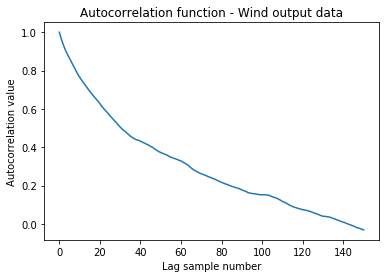

In [152]:
from statsmodels.tsa.stattools import acf
autocorrelation = acf(temp6, nlags= 150)
plt.title("Autocorrelation function - Wind output data")
plt.xlabel("Lag sample number")
plt.ylabel("Autocorrelation value")
plt.plot(autocorrelation)

/Users/adi/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning:

'pandas.tools.plotting.autocorrelation_plot' is deprecated, import 'pandas.plotting.autocorrelation_plot' instead.



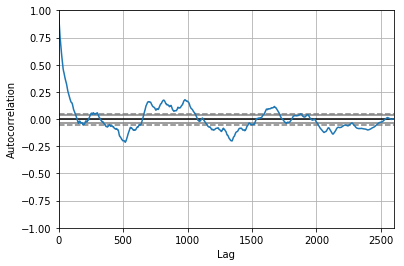

In [98]:
from pandas.tools.plotting import autocorrelation_plot
autocorrelation_plot(temp6)